# BertViz Interactive Demo
## **Scroll down for pre-loaded visualizations** 👇👇👇👇👇👇


In [ ]:
!pip install bertviz

In [ ]:
# Load model and retrieve attention weights

from bertviz import head_view, model_view
from transformers import BertTokenizer, BertModel

model_version = 'bert-base-uncased'
do_lower_case = True
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=do_lower_case)
sentence_a = "The city councilmen refused the demonstrators a permit because they feared violence."
sentence_b = "The city councilmen refused the demonstrators a permit because they advocated violence."
inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt', add_special_tokens=True)
input_ids = inputs['input_ids']
token_type_ids = inputs['token_type_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[-1]
sentence_b_start = token_type_ids[0].tolist().index(1)
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list) 

In [ ]:
import numpy as np  
import torch

l_pronoun = ["i","you","he","she","it","we","they","them","us","him","her","his","hers","its","theirs","our","your"]

def create_link(sentence_a, sentence_b, ant_gold_a, ant_gold_b, model, tokenizer):
  inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt', add_special_tokens=True)
  input_ids = inputs['input_ids']
  token_type_ids = inputs['token_type_ids']
  attention = model(input_ids, token_type_ids=token_type_ids)[-1]
  sentence_b_start = token_type_ids[0].tolist().index(1)
  input_id_list = input_ids[0].tolist() # Batch index 0
  tokens = tokenizer.convert_ids_to_tokens(input_id_list)

  antecedents = [ant_gold_a, ant_gold_b]
  pron_links = np.zeros((12,12))
  token_ind =[]

  for token in l_pronoun:
    if token in tokens :
      token_ind.append(tokens.index(token))

  for layer in range(12):
    for head in range(12):
      for ind in token_ind:
        vals = attention[layer][0][head][ind]
        topk = torch.topk(vals, 3)
        topk_tokens = [tokens[index.item()] for index in topk.indices]
        ss = torch.sum(torch.Tensor([attention[layer][0][head][ind][index.item()] for index in topk.indices]))
        for elem in antecedents:
          for k, tk in enumerate(topk_tokens):
            if elem == tk:
              pron_links[layer,head]+= 1
  return pron_links

In [ ]:
import numpy as np  
import torch
def create_true_link(sentence_a, sentence_b, ant_gold_a, ant_gold_b, model, tokenizer):
  inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt', add_special_tokens=True)
  input_ids = inputs['input_ids']
  token_type_ids = inputs['token_type_ids']
  attention = model(input_ids, token_type_ids=token_type_ids)[-1]
  sentence_b_start = token_type_ids[0].tolist().index(1)
  input_id_list = input_ids[0].tolist() # Batch index 0
  tokens = tokenizer.convert_ids_to_tokens(input_id_list)

  antecedents = [ant_gold_a, ant_gold_b]
  pron_links = np.zeros((12,12))
  token_ind =[]

  for token in l_pronoun:
    if token in tokens :
      token_ind.append(tokens.index(token))

  for layer in range(12):
    for head in range(12):
      i = 0
      for ind in token_ind:
        vals = attention[layer][0][head][ind]
        topk = torch.topk(vals, 3)
        topk_tokens = [tokens[index.item()] for index in topk.indices]
        ss = torch.sum(torch.Tensor([attention[layer][0][head][ind][index.item()] for index in topk.indices]))        
        if (i == 0 and ant_gold_a in topk_tokens and ant_gold_b not in topk_tokens ):
          pron_links[layer,head]+= 1
        if (i == 1 and ant_gold_a not in topk_tokens and ant_gold_b  in topk_tokens ):
          pron_links[layer,head]+= 1
        i += 1       
  return pron_links

# Regular Scheme


In [ ]:
!wget https://raw.githubusercontent.com/gabrielStanovsky/mt_gender/master/data/aggregates/en_pro.txt

In [ ]:
import pandas as pd
df = pd.read_csv("en_pro.txt", sep = "\t", names = ["sex", "ind", "phrase", "gold"])
df.head()

,sex,ind,phrase,gold
0,male,1,The developer argued with the designer because...,developer
1,female,5,The developer argued with the designer because...,designer
2,male,1,The mechanic gave the clerk a present because ...,mechanic
3,female,4,The mechanic gave the clerk a present because ...,clerk
4,male,1,The mover said thank you to the housekeeper be...,mover


In [ ]:
from tqdm import tqdm_notebook
total_pron_links = np.zeros((12, 12))
true_total_pron_links = np.zeros((12, 12))
for i in tqdm_notebook(range(0, df.shape[0], 2)):
  s1 = df["phrase"].iloc[i]
  s2 = df["phrase"].iloc[i + 1]
  g1 = df["gold"].iloc[i]
  g2 = df["gold"].iloc[i + 1]

  m = create_link(s1, s2, g1, g2, model, tokenizer)
  total_pron_links += m
  m_true = create_true_link(s1, s2, g1, g2, model, tokenizer)
  true_total_pron_links += m_true
total_pron_links = total_pron_links/df.shape[0]
true_total_pron_links = true_total_pron_links/df.shape[0]

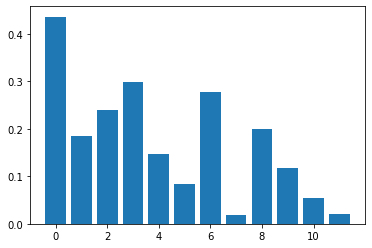

In [ ]:
import matplotlib.pyplot as plt

plt.bar(range(12), torch.Tensor(total_pron_links).mean(axis = 1))
plt.show()

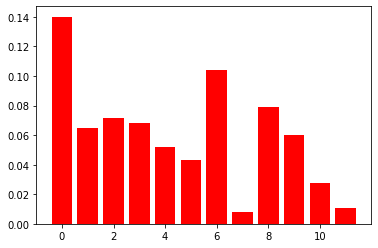

In [ ]:
plt.bar(range(12), torch.Tensor(true_total_pron_links).mean(axis = 1), color="red")
plt.show()

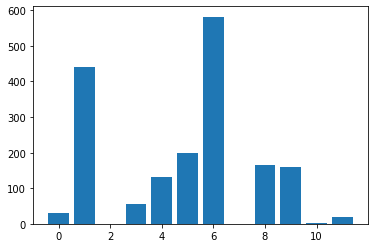

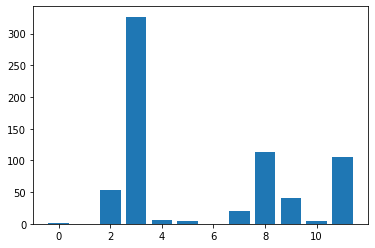

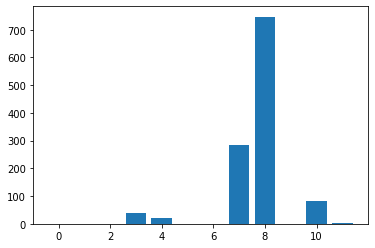

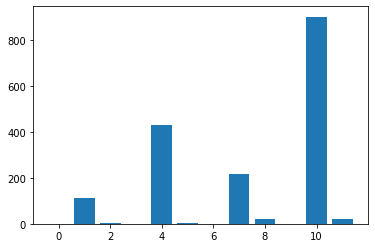

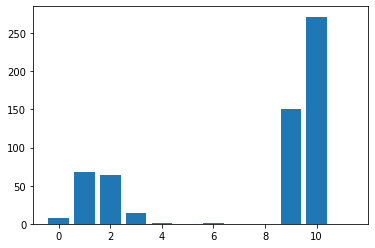

...

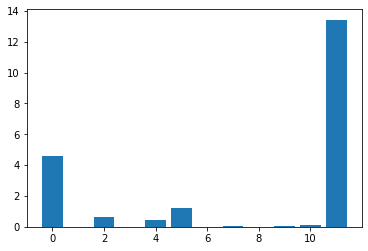

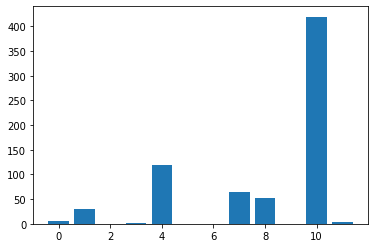

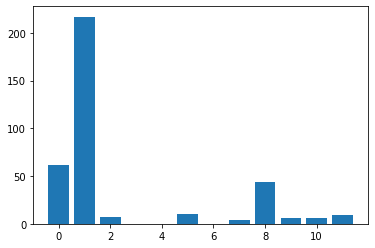

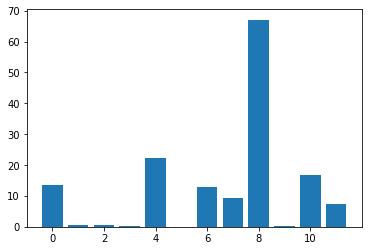

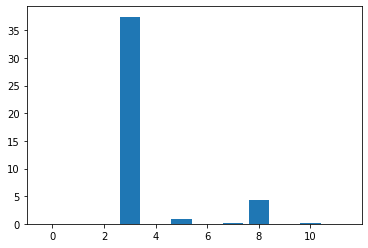

In [ ]:
import matplotlib.pyplot as plt
for i in range(12):
  plt.bar(range(12), total_pron_links[i, :])
  plt.show()

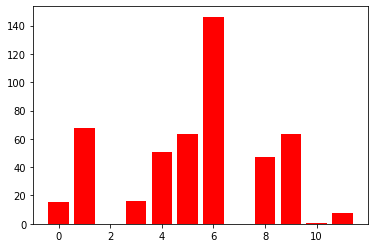

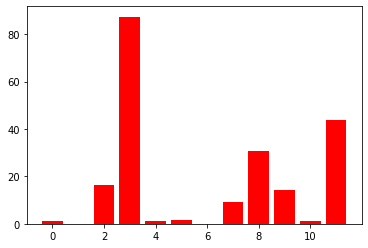

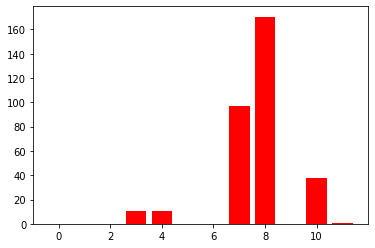

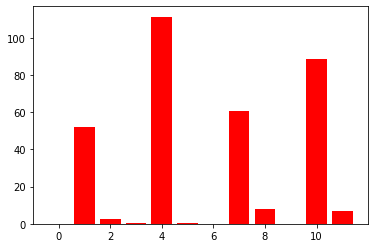

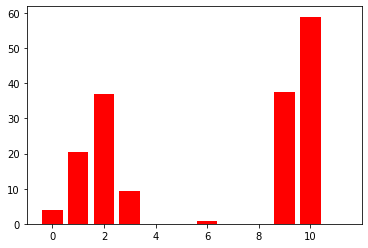

...

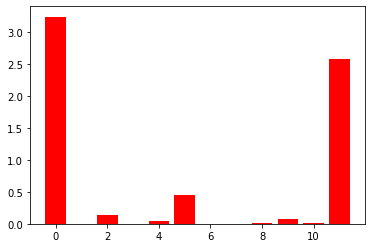

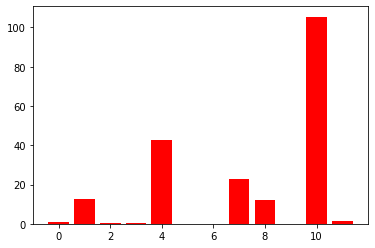

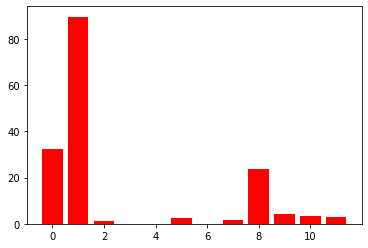

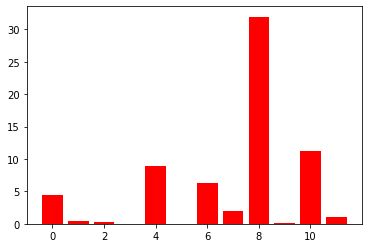

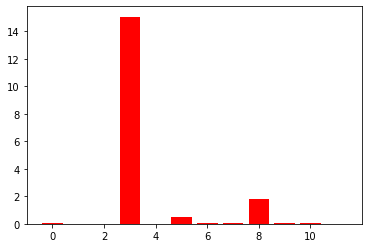

In [ ]:
import matplotlib.pyplot as plt
for i in range(12):
  plt.bar(range(12), true_total_pron_links[i, :], color= "red")
  plt.show()

# Winograd Scheme


In [ ]:
pip install datasets

In [ ]:
from datasets import load_dataset
dataset = load_dataset('winograd_wsc', 'wsc285')
dataset

Downloading:   0%|          | 0.00/2.08k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.07k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/113k [00:00<?, ?B/s]

0 examples [00:00, ? examples/s]

Dataset winograd_wsc downloaded and prepared to /root/.cache/huggingface/datasets/winograd_wsc/wsc285/0.0.0/0651311f3b6dda14889d9a063030a02458395ee50ab9f41cca4cd5a89c0c3dce. Subsequent calls will reuse this data.


  0%|          | 0/1 [00:00<?, ?it/s]

DatasetDict({
    test: Dataset({
        features: ['text', 'pronoun', 'pronoun_loc', 'quote', 'quote_loc', 'options', 'label', 'source'],
        num_rows: 285
    })
})

In [ ]:
del dataset_txt[254]
del dataset_txt[253]
del dataset_txt[252]

del dataset_label[254]
del dataset_label[253]
del dataset_label[252]

del dataset_option[254]
del dataset_option[253]
del dataset_option[252]

In [ ]:
from tqdm import tqdm_notebook
total_pron_links = np.zeros((12, 12))
true_total_pron_links = np.zeros((12, 12))
for i in tqdm_notebook(range(0, len(dataset_txt), 2)):
  s1 = dataset_txt[i]
  s2 = dataset_txt[i + 1]
  g1 = dataset_option[i][dataset_label[i]]
  g2 = dataset_option[i][dataset_label[i + 1]]

  m = create_link(s1, s2, g1, g2, model, tokenizer)
  total_pron_links += m
  m_true = create_true_link(s1, s2, g1, g2, model, tokenizer)
  true_total_pron_links += m_true
total_pron_links = total_pron_links/df.shape[0]
true_total_pron_links = true_total_pron_links/df.shape[0]

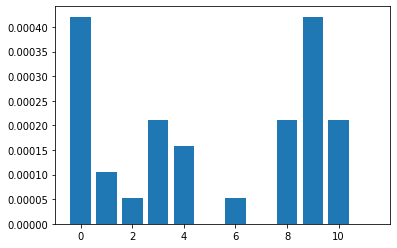

In [ ]:
plt.bar(range(12), torch.Tensor(total_pron_links).mean(axis = 1))
plt.show()

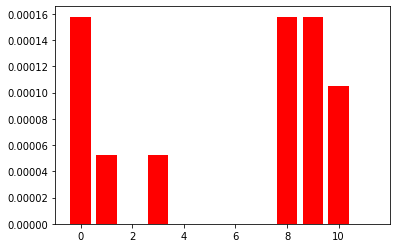

In [ ]:
plt.bar(range(12), torch.Tensor(true_total_pron_links).mean(axis = 1), color="red")
plt.show()

# Model View
The model view gives a birds-eye view of attention across all of the layers (rows) and heads (columns) in the model. In this case we are showing *bert-base*, which has 12 layers and 12 heads (zero-indexed). 

## Usage
* **Click** on any **cell** for a detailed view of attention for the associated attention head.
* Then **hover** over any **token** on the left side of detail view to filter the attention from that token.
* The lines show the attention from each token (left) to every other token (right). Darker lines indicate higher attention weights.  

In [ ]:
#@title
model_view(attention, tokens, sentence_b_start)

<IPython.core.display.Javascript object>

# Head View
The attention-head view visualizes attention in one or more heads in a particular layer in the model.

## Usage
* **Hover** over any **token** on the left/right side of the visualization to filter attention from/to that token. The colors correspond to different attention heads.
* **Double-click** on any of the **colored tiles** at the top to filter to the corresponding attention head.
* **Single-click** on any of the **colored tiles** to toggle selection of the corresponding attention head. 
* **Click** on the **Layer** drop-down to change the model layer (zero-indexed).
* The lines show the attention from each token (left) to every other token (right). Darker lines indicate higher attention weights. When multiple heads are selected, the attention weights are overlaid on one another. 

In [ ]:
head_view(attention, tokens, sentence_b_start)

<IPython.core.display.Javascript object>

# Neuron View
The attention-head view visualizes attention, as well as query and key values, in a particuler attention head.

## Usage
* **Hover** over any of the tokens on the left side of the visualization to filter attention from that token.
* Then **click** on the **plus** icon that is revealed when hovering. This shows the query vectors, key vectors, and intermediate computations for the attention weights (<span style='color:blue'>blue</span>=positive, <span style='color:#ff6318'>orange</span>=negative).  
* Once in the expanded view, **hover** over any other **token** on the left to see the associated attention computations.
* **Click** on the **Layer** or **Head** drop-downs to change the model layer or head (zero-indexed).

In [ ]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=do_lower_case)
model_type = 'bert'
show(model, model_type, tokenizer, sentence_a, sentence_b, layer=1, head=0)

100%|██████████| 231508/231508 [00:00<00:00, 3788232.59B/s]
